# BOOT CAMP THE BRIDGE DATA SCIENCE
# PROYECTO EDA - OLIVIER KIRSTETTER - JULIO 2021
# NOTEBOOK

## Objectivo: analisis de datos de pozos para discriminar arenas a partir de propriedades elásticas

###### The well log data used in this repo is licensed as Norwegian License for Open Government Data (NLOD) 2.0. “Lithofacies data was provided by the FORCE Machine Learning competition with well logs and seismic 2020”. 
###### Fuente de los datos: https://xeek.ai/challenges/force-well-logs/overview -  Se necesita suscribirse a la pagina xeek.ai

In [1]:
import pandas as pd
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import math

# at the top of the file, before other imports
import warnings

warnings.filterwarnings('ignore')

# no warnings will be printed from now on

In [2]:

# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load in 

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# plotly
# import plotly.plotly as py
from plotly.offline import init_notebook_mode, iplot, plot
import plotly as py
init_notebook_mode(connected=True)
import plotly.graph_objs as go

# word cloud library
from wordcloud import WordCloud

# matplotlib
import matplotlib.pyplot as plt
# Input data files are available in the "../input/" directory.
# For example, running this (by clicking run or pressing Shift+Enter) will list the files in the input directory

import os
print(os.listdir("./Input_data"))

# Any results you write to the current directory are saved as output.

['train.csv']


# Funciones

### 1/ Función que transforma las coordenades UTM en longitud y latitud 

#### (fuente:https://stackoverflow.com/questions/343865/how-to-convert-from-utm-to-latlng-in-python-or-javascript)

In [3]:
def utmToLatLng(zone, easting, northing, northernHemisphere=True):
    
    if not northernHemisphere:
        northing = 10000000 - northing

    a = 6378137
    e = 0.081819191
    e1sq = 0.006739497
    k0 = 0.9996

    arc = northing / k0
    mu = arc / (a * (1 - math.pow(e, 2) / 4.0 - 3 * math.pow(e, 4) / 64.0 - 5 * math.pow(e, 6) / 256.0))

    ei = (1 - math.pow((1 - e * e), (1 / 2.0))) / (1 + math.pow((1 - e * e), (1 / 2.0)))

    ca = 3 * ei / 2 - 27 * math.pow(ei, 3) / 32.0

    cb = 21 * math.pow(ei, 2) / 16 - 55 * math.pow(ei, 4) / 32
    cc = 151 * math.pow(ei, 3) / 96
    cd = 1097 * math.pow(ei, 4) / 512
    phi1 = mu + ca * math.sin(2 * mu) + cb * math.sin(4 * mu) + cc * math.sin(6 * mu) + cd * math.sin(8 * mu)

    n0 = a / math.pow((1 - math.pow((e * math.sin(phi1)), 2)), (1 / 2.0))

    r0 = a * (1 - e * e) / math.pow((1 - math.pow((e * math.sin(phi1)), 2)), (3 / 2.0))
    fact1 = n0 * math.tan(phi1) / r0

    _a1 = 500000 - easting
    dd0 = _a1 / (n0 * k0)
    fact2 = dd0 * dd0 / 2

    t0 = math.pow(math.tan(phi1), 2)
    Q0 = e1sq * math.pow(math.cos(phi1), 2)
    fact3 = (5 + 3 * t0 + 10 * Q0 - 4 * Q0 * Q0 - 9 * e1sq) * math.pow(dd0, 4) / 24

    fact4 = (61 + 90 * t0 + 298 * Q0 + 45 * t0 * t0 - 252 * e1sq - 3 * Q0 * Q0) * math.pow(dd0, 6) / 720

    lof1 = _a1 / (n0 * k0)
    lof2 = (1 + 2 * t0 + Q0) * math.pow(dd0, 3) / 6.0
    lof3 = (5 - 2 * Q0 + 28 * t0 - 3 * math.pow(Q0, 2) + 8 * e1sq + 24 * math.pow(t0, 2)) * math.pow(dd0, 5) / 120
    _a2 = (lof1 - lof2 + lof3) / math.cos(phi1)
    _a3 = _a2 * 180 / math.pi

    latitude = 180 * (phi1 - fact1 * (fact2 + fact3 + fact4)) / math.pi

    if not northernHemisphere:
        latitude = -latitude

    longitude = ((zone > 0) and (6 * zone - 183.0) or 3.0) - _a3

    return (latitude, longitude)


### 2/ Función que genera un nuevo set de datos con longitud y latitud

In [4]:
def calc_coord(data):
    data_coord=data.loc[:,["WELL", "DEPTH_MD","X_LOC","Y_LOC"]]
    l=data_coord[data_coord["WELL"]==list(data_coord["WELL"].unique())[0]]
    all_well=l[l["DEPTH_MD"]==l["DEPTH_MD"].min()]
    lat,lon=utmToLatLng(31, all_well["X_LOC"], all_well["Y_LOC"])
    all_well["lat"]=lat
    all_well["lon"]=lon
    for i in range(1,data.WELL.nunique()):
        all_well_prov=data_coord[data_coord["WELL"]==list(data_coord["WELL"].unique())[i]]
        all_well_prov2=all_well_prov[all_well_prov["DEPTH_MD"]==all_well_prov["DEPTH_MD"].min()]
        lat,lon=utmToLatLng(31, all_well_prov2["X_LOC"], all_well_prov2["Y_LOC"])
        all_well_prov2["lat"]=lat
        all_well_prov2["lon"]=lon
        all_well=pd.concat([all_well,all_well_prov2])
        all_well.reset_index(inplace=True, drop=True)
        all_well2=all_well
        all_well2.dropna(inplace=True)
    return all_well2

### 3/ Función que genera un gráfico para cada pozo de los logs de interés incluyendo profundidad (Measured depth) en metros, GamaRay (en API), VP/VS, VP, densidad (Rhob) en kg/m3, porosity (NPHI), resistividad (RDEP) en Ohm.m, y lithologia.

In [5]:
def plot_logs(p):
    yb=p.iloc[0]["DEPTH_MD"]-10
    yh=p.iloc[-1]["DEPTH_MD"]+10

    x1l=p.GR.min()
    x1h=p.GR.max()
    x2l=p["VP/VS"].min()
    x2h=p["VP/VS"].max()
    x3l=p.VP.min()
    x3h=p.VP.max()
    x4l=p.RHOB.min()
    x4h=p.RHOB.max()
    x5l=p.NPHI.min()
    x5h=p.NPHI.max()
    x6l=p.RDEP.min()
    x6h=p.RDEP.max()

    fig = plt.subplots(figsize=(25,10))
    plt.suptitle(p.WELL.unique())

    ax1 = plt.subplot2grid((1,7), (0,0), rowspan=1, colspan = 1) 
    ax2 = plt.subplot2grid((1,7), (0,1), rowspan=1, colspan = 1)
    ax3 = plt.subplot2grid((1,7), (0,2), rowspan=1, colspan = 1)
    ax4 = plt.subplot2grid((1,7), (0,3), rowspan=1, colspan = 1)
    ax5 = plt.subplot2grid((1,7), (0,4), rowspan=1, colspan = 1)
    ax6 = plt.subplot2grid((1,7), (0,5), rowspan=1, colspan = 1)
    ax7 = plt.subplot2grid((1,7), (0,6), rowspan=1, colspan = 1)

    ax1.plot("GR", "DEPTH_MD", data = p, color = "green")
    ax1.set_title("Gamma Ray (API)")
    ax1.set_xlim(x1l, x1h) 
    ax1.set_ylim(yh, yb) 
    ax1.grid() 
    ax1.set_ylabel("Measured depth (m)")

    ax2.plot("VP/VS", "DEPTH_MD", data =p, color = "red")
    ax2.set_title("VP/VS")
    ax2.set_xlim(x2l, x2h)
    ax2.set_ylim(yh, yb)
    ax2.grid()

    ax3.plot("VP", "DEPTH_MD", data = p, color = "blue")
    ax3.set_title("Vp (m/s)")
    ax3.set_xlim(x3l, x3h)
    ax3.set_ylim(yh, yb)
    ax3.grid()

    ax4.plot("RHOB", "DEPTH_MD", data = p, color = "green")
    ax4.set_title("RHOB (kg/m3)")
    ax4.set_xlim(x4l, x4h)
    ax4.set_ylim(yh, yb)
    ax4.grid()
    
    ax5.plot("NPHI", "DEPTH_MD", data = p, color = "red")
    ax5.set_title("NPHI")
    ax5.set_xlim(x5l, x5h)
    ax5.set_ylim(yh, yb)
    ax5.grid()
    
    ax6.plot("RDEP", "DEPTH_MD", data = p, color = "blue")
    ax6.set_title("Resistivity (Ohm.m)")
    ax6.set_xlim(x6l, x6h)
    ax6.set_ylim(yh, yb)
    ax6.grid()
    
    ax7.plot("LITH_number", "DEPTH_MD", data = p, color = "black")
    ax7.set_title("LITH")
    ax7.set_xlim(0,10)
    ax7.set_ylim(yh, yb)
    ax7.grid()
    
    


### 4/ Función que genera un plot Plotly para los pozos elegidos para análisis detallado

In [6]:
def plot_final(p):
    # import graph objects as "go"
    import plotly.graph_objs as go
    from plotly.subplots import make_subplots

    fig = make_subplots(rows=1, cols=8, shared_yaxes=True)


    # Creating trace1
    fig.add_trace(go.Scatter(
                        x = p['FORMATION'],
                        y = p['DEPTH_MD'],
                        name = 'FORMATION',
                        mode= 'lines',
                        marker = dict(color = 'rgba(16, 112, 2, 0.8)'),
                        text = ''), row=1, col=1)
    
    # Creating trace2
    fig.add_trace(go.Scatter(
                        x = p['GR'],
                        y = p['DEPTH_MD'],
                        name = 'GR',
                        mode= 'lines',
                        marker = dict(color = 'rgba(16, 112, 2, 0.8)'),
                        text = 'GR'), row=1, col=2)
    # Creating trace3
    fig.add_trace(go.Scatter(
                        x = p['VP/VS'],
                        y = p['DEPTH_MD'],
                        name = 'VP/VS',
                        mode= 'lines',
                        marker = dict(color = 'rgba(16, 112, 2, 0.8)'),
                        text = 'VP/VS'), row=1, col=3)
    

    # Creating trace4
    fig.add_trace(go.Scatter(
                        x = p['AI'],
                        y = p['DEPTH_MD'],
                        name = 'AI',
                        mode= 'lines',
                        marker = dict(color = 'rgba(16, 112, 2, 0.8)'),
                        text = 'AI'), row=1, col=4)
    
    # Creating trace5
    fig.add_trace(go.Scatter(
                        x = p['RHOB'],
                        y = p['DEPTH_MD'],
                        name = 'RHOB',
                        mode= 'lines',
                        marker = dict(color = 'rgba(16, 112, 2, 0.8)'),
                        text = 'RHOB'), row=1, col=5)

    

    
    # Creating trace6
    fig.add_trace(go.Scatter(
                        x = p['NPHI'],
                        y = p['DEPTH_MD'],
                        name = 'NPHI',
                        mode= 'lines',
                        marker = dict(color = 'rgba(16, 112, 2, 0.8)'),
                        text = 'NPHI'), row=1, col=6)
    
    
    # Creating trace7
    fig.add_trace(go.Scatter(
                        x = p['RDEP'],
                        y = p['DEPTH_MD'],
                        name = 'RDEP',
                        mode= 'lines',
                        marker = dict(color = 'rgba(16, 112, 2, 0.8)'),
                        text = 'RDEP'), row=1, col=7)    
    
     # Creating trace8
    fig.add_trace(go.Scatter(
                        x = p['LITH'],
                        y = p['DEPTH_MD'],
                        name = 'LITH',
                        mode= 'lines',
                        marker = dict(color = 'rgba(16, 112, 2, 0.8)'),
                        text = ''), row=1, col=8) 
        


    # Create axis objects
    fig.update_layout(
            title=dict(text="WELL" +" " +p.iloc[1]["WELL"], 
            y=0.9, x=0.5, 
            xanchor= 'center',
            yanchor= 'top'),

        
            xaxis1=dict(title="",
            titlefont=dict(color="#1f77b4"),
            domain=[0.02, 0.12], nticks=3),
        
            xaxis2=dict(title="GR",
            titlefont=dict(color="#1f77b4"),
            domain=[0.14,0.24], nticks=3),

            xaxis3=dict(title="VP/VS",
            titlefont=dict(color="#1f77b4"),
            domain=[0.26, 0.36], nticks=3),

            xaxis4=dict(title="AI",
            titlefont=dict(color="#1f77b4"),
            domain=[0.38, 0.48], nticks=3),
        
            xaxis5=dict(title="RHOB",
            titlefont=dict(color="#1f77b4"),
            domain=[0.50, 0.60], nticks=3),
        
            xaxis6=dict(title="NPHI",
            titlefont=dict(color="#1f77b4"),
            domain=[0.62, 0.72], nticks=3),
        
            xaxis7=dict(title="RDEP",
            titlefont=dict(color="#1f77b4"),
            domain=[0.74, 0.84], nticks=3),
        
        
            xaxis8=dict(title="",
            titlefont=dict(color="#1f77b4"),
            domain=[0.86, 0.96], nticks=3),


        yaxis1=dict(
            title="Measured depth (m)",
            titlefont=dict(color="#1f77b4"),
            tickfont=dict(color="#1f77b4"),
            anchor="free",
            overlaying="y",
            side="left",
            range=[p["DEPTH_MD"].max(), p["DEPTH_MD"].min()],
            position=0.01, nticks=10),
    )

    fig.show()

# Código principal

### Carga de datos y limpieza

In [7]:
data=pd.read_csv(r"./Input_data/train.csv", sep=";")

In [8]:
data.shape

(1170511, 29)

In [9]:
data.columns

Index(['WELL', 'DEPTH_MD', 'X_LOC', 'Y_LOC', 'Z_LOC', 'GROUP', 'FORMATION',
       'CALI', 'RSHA', 'RMED', 'RDEP', 'RHOB', 'GR', 'SGR', 'NPHI', 'PEF',
       'DTC', 'SP', 'BS', 'ROP', 'DTS', 'DCAL', 'DRHO', 'MUDWEIGHT', 'RMIC',
       'ROPA', 'RXO', 'FORCE_2020_LITHOFACIES_LITHOLOGY',
       'FORCE_2020_LITHOFACIES_CONFIDENCE'],
      dtype='object')

In [10]:
data.WELL.unique()

array(['15/9-13', '15/9-15', '15/9-17', '16/1-2', '16/1-6 A', '16/10-1',
       '16/10-2', '16/10-3', '16/10-5', '16/11-1 ST3', '16/2-11 A',
       '16/2-16', '16/2-6', '16/4-1', '16/5-3', '16/7-4', '16/7-5',
       '16/8-1', '17/11-1', '25/11-15', '25/11-19 S', '25/11-5',
       '25/2-13 T4', '25/2-14', '25/2-7', '25/3-1', '25/4-5', '25/5-1',
       '25/5-4', '25/6-1', '25/6-2', '25/6-3', '25/7-2', '25/8-5 S',
       '25/8-7', '25/9-1', '26/4-1', '29/6-1', '30/3-3', '30/3-5 S',
       '30/6-5', '31/2-1', '31/2-19 S', '31/2-7', '31/2-8', '31/2-9',
       '31/3-1', '31/3-2', '31/3-3', '31/3-4', '31/4-10', '31/4-5',
       '31/5-4 S', '31/6-5', '31/6-8', '32/2-1', '33/5-2', '33/6-3 S',
       '33/9-1', '33/9-17', '34/10-19', '34/10-21', '34/10-33',
       '34/10-35', '34/11-1', '34/11-2 S', '34/12-1', '34/2-4',
       '34/3-1 A', '34/4-10 R', '34/5-1 A', '34/5-1 S', '34/7-13',
       '34/7-20', '34/7-21', '34/8-1', '34/8-3', '34/8-7 R', '35/11-1',
       '35/11-10', '35/11-11', '35/11-12

In [11]:
data.drop(columns=['RSHA', 'RMED', 'SGR','CALI','PEF','SP', 'BS', 'ROP', 'DCAL', 'DRHO', 'MUDWEIGHT', 'RMIC',
       'ROPA', 'RXO','FORCE_2020_LITHOFACIES_CONFIDENCE'], inplace=True)

 ### Generación de las litologias a partir de los índices de litología presntes en el fichero csv (fuente: xeek.ai)

In [12]:

lithology_numbers = {30000: 'Sandstone',
                 65030: 'Sandstone/Shale',
                 65000: 'Shale',
                 80000: 'Marl',
                 74000: 'Dolomite',
                 70000: 'Limestone',
                 70032: 'Chalk',
                 88000: 'Halite',
                 86000: 'Anhydrite',
                 99000: 'Tuff',
                 90000: 'Coal',
                 93000: 'Basement'}

In [13]:
data['LITH'] = data['FORCE_2020_LITHOFACIES_LITHOLOGY'].map(lithology_numbers)
data.columns

Index(['WELL', 'DEPTH_MD', 'X_LOC', 'Y_LOC', 'Z_LOC', 'GROUP', 'FORMATION',
       'RDEP', 'RHOB', 'GR', 'NPHI', 'DTC', 'DTS',
       'FORCE_2020_LITHOFACIES_LITHOLOGY', 'LITH'],
      dtype='object')

In [14]:
data.rename({'FORCE_2020_LITHOFACIES_LITHOLOGY':'LITH_number'}, axis=1, inplace=True)

In [15]:
data["LITH_number"]=data["LITH_number"]/10000

In [16]:
data["Z_LOC"]=data["Z_LOC"]*(-1)

In [17]:
data_coord=data.drop(columns=['Z_LOC', 'GROUP', 'FORMATION','RDEP', 'RHOB', 'GR', 'NPHI', 'DTC', 'DTS',
       'LITH_number', 'LITH'])

In [18]:
data_coord.columns

Index(['WELL', 'DEPTH_MD', 'X_LOC', 'Y_LOC'], dtype='object')

In [19]:
data.columns

Index(['WELL', 'DEPTH_MD', 'X_LOC', 'Y_LOC', 'Z_LOC', 'GROUP', 'FORMATION',
       'RDEP', 'RHOB', 'GR', 'NPHI', 'DTC', 'DTS', 'LITH_number', 'LITH'],
      dtype='object')

### Generación e exportación del fichero con las longitudes y latitudes para cargar en Streamlit

In [20]:
data_coord_lon_lat=calc_coord(data_coord)

In [21]:
data_coord_lon_lat

,WELL,DEPTH_MD,X_LOC,Y_LOC,lat,lon
0,15/9-13,494.528000,437641.96875,6470972.5,58.375153,1.933836
1,15/9-15,485.256000,436817.90625,6462991.5,58.303366,1.921935
2,15/9-17,472.429998,438591.96875,6478951.5,58.446938,1.947942
3,16/1-2,2645.580001,455221.34375,6533321.5,58.937216,2.221999
4,16/1-6 A,1175.979735,459499.68750,6539423.0,58.992433,2.295208
...,...,...,...,...,...,...
86,35/9-2,1005.688358,550199.50000,6800708.0,61.337201,3.938129
87,35/9-5,2726.167587,543505.68750,6799385.5,61.326136,3.812743
88,35/9-6 S,1725.152000,537126.50000,6804497.0,61.372681,3.694598
89,36/7-3,2391.104000,556075.18750,6810860.0,61.427522,4.050967


In [22]:
data_coord_lon_lat.to_csv (r'./Output_data/all_coord_only_all_wells.csv', index = False, header=True)

### Seleción de los pozos con registro del log DTS (well_DTS)

In [23]:
data.groupby("WELL")["DTS"].count().sort_values(ascending=False)

WELL
35/4-1      16873
35/11-6     13567
34/5-1 A    13295
35/11-11    12687
33/6-3 S    12576
            ...  
33/9-17         0
34/10-19        0
34/10-21        0
34/10-33        0
15/9-13         0
Name: DTS, Length: 98, dtype: int64

In [24]:
well_DTS=data[data["DTS"]>=10]

In [25]:
print(well_DTS["WELL"].nunique())
well_DTS.reset_index(inplace=True, drop=True)

32


In [26]:
well_DTS.groupby("WELL")["DTS"].describe().sort_values("count", ascending=False)

,count,mean,std,min,25%,50%,75%,max
WELL,,,,,,,,
35/4-1,16873.0,188.472153,42.063814,92.483284,155.322510,192.570587,214.835861,342.638306
35/11-6,13567.0,274.952709,94.747401,69.163177,207.959763,249.254547,351.685791,627.135681
34/5-1 A,13295.0,221.207398,33.384322,140.492538,199.904198,215.337570,229.750496,331.669434
35/11-11,12687.0,234.697921,96.417013,94.645958,154.947800,213.800781,297.330460,590.718933
33/6-3 S,12576.0,200.474913,23.728892,93.631721,188.070045,202.402107,219.040813,278.894318
25/6-3,11985.0,305.877066,85.955835,100.188965,258.038208,294.812286,359.532471,676.578125
31/2-19 S,10032.0,228.796456,77.734788,105.889938,166.805168,213.737022,258.896301,549.770142
34/12-1,8899.0,168.734922,24.583333,102.617188,152.188934,171.313828,182.787422,290.514832
35/11-10,6206.0,163.293658,21.193641,99.448807,151.975029,161.560898,171.796715,339.809662


In [27]:
well_DTS.shape

(174613, 15)

In [28]:
well_DTS.columns

Index(['WELL', 'DEPTH_MD', 'X_LOC', 'Y_LOC', 'Z_LOC', 'GROUP', 'FORMATION',
       'RDEP', 'RHOB', 'GR', 'NPHI', 'DTC', 'DTS', 'LITH_number', 'LITH'],
      dtype='object')

### Cálculo de propriedades adicionales (velocidad VP (m/s), velocidad VS (m/s), VP/VS, impedancia acústica  AI (m/s.kg/m3))

In [29]:
well_DTS["VP/VS"]=well_DTS.DTS /well_DTS.DTC
well_DTS["VP"]= 1./well_DTS.DTC * 1000000*0.3048
well_DTS["VS"]= 1./well_DTS.DTS * 1000000*0.3048
well_DTS["AI"]= well_DTS.RHOB *well_DTS.VP/1000

In [30]:
well_DTS.columns

Index(['WELL', 'DEPTH_MD', 'X_LOC', 'Y_LOC', 'Z_LOC', 'GROUP', 'FORMATION',
       'RDEP', 'RHOB', 'GR', 'NPHI', 'DTC', 'DTS', 'LITH_number', 'LITH',
       'VP/VS', 'VP', 'VS', 'AI'],
      dtype='object')

### Control de calidad de los datos

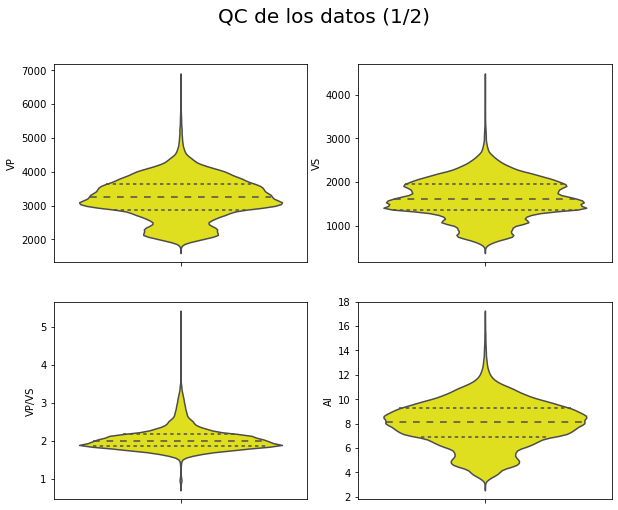

In [31]:
fig, axes = plt.subplots(2, 2, figsize=(10,8))

fig.suptitle('QC de los datos (1/2)', fontsize=20, color="black")

sns.violinplot(ax=axes[ 0,0], data=well_DTS,  y='VP',color='yellow', inner="quartile")
sns.violinplot(ax=axes[ 0,1], data=well_DTS, y='VS', color='yellow', inner="quartile")
sns.violinplot(ax=axes[ 1,0], data=well_DTS, y='VP/VS', color='yellow', inner="quartile")
sns.violinplot(ax=axes[ 1,1], data=well_DTS, y='AI', color='yellow', inner="quartile");


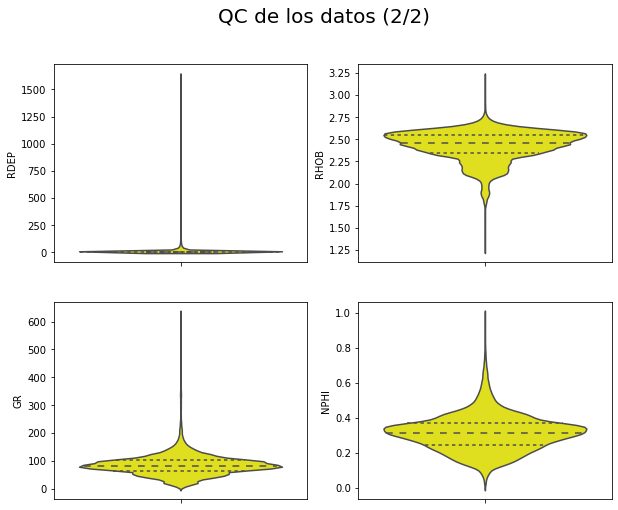

In [32]:
fig, axes = plt.subplots(2, 2, figsize=(10,8))

fig.suptitle('QC de los datos (2/2)', fontsize=20, color="black")

sns.violinplot(ax=axes[ 0,0], data=well_DTS,  y='RDEP',color='yellow', inner="quartile")
sns.violinplot(ax=axes[ 0,1], data=well_DTS, y='RHOB', color='yellow', inner="quartile")
sns.violinplot(ax=axes[ 1,0], data=well_DTS, y='GR', color='yellow', inner="quartile")
sns.violinplot(ax=axes[ 1,1], data=well_DTS, y='NPHI', color='yellow', inner="quartile");

In [33]:
well_DTS["VP"].describe().round(2)

count    174596.00
mean       3235.19
std         606.21
min        1702.81
25%        2879.95
50%        3241.13
75%        3641.25
max        6798.78
Name: VP, dtype: float64

In [34]:
well_DTS["VS"].describe().round(2)

count    174613.00
mean       1632.85
std         449.75
min         450.50
25%        1356.81
50%        1619.55
75%        1954.64
max        4406.97
Name: VS, dtype: float64

In [35]:
well_DTS["VP/VS"].describe().round(2)

count    174596.00
mean          2.05
std           0.31
min           0.75
25%           1.86
50%           2.00
75%           2.16
max           5.36
Name: VP/VS, dtype: float64

In [36]:
well_DTS["AI"].describe().round(2)

count    159073.00
mean          8.02
std           1.84
min           2.86
25%           6.90
50%           8.11
75%           9.24
max          16.93
Name: AI, dtype: float64

###  Generación e exportación del fichero con las longitudes y latitudes de los pozos conteniendo el log DTS

In [37]:
data_coord_lon_lat_well_DTS=calc_coord(well_DTS)
data_coord_lon_lat_well_DTS

,WELL,DEPTH_MD,X_LOC,Y_LOC,lat,lon
0,16/10-3,2110.365599,460436.84375,6453743.5,58.223071,2.326476
1,16/10-5,2632.236387,448701.78125,6429298.0,58.002320,2.132074
2,16/2-11 A,1755.555200,475493.50000,6518867.0,58.809045,2.575791
3,16/2-16,1669.078396,476768.21875,6523588.5,58.851518,2.597364
4,16/2-6,1629.098799,477771.40625,6520630.5,58.825006,2.615045
5,16/5-3,1508.990000,474410.78125,6510408.5,58.733019,2.558015
6,25/6-3,626.323729,495697.25000,6618248.0,59.702190,2.923545
7,25/8-5 S,1900.110400,463945.21875,6591236.0,59.458101,2.363965
8,31/2-19 S,1537.278400,520157.59375,6753015.0,60.911751,3.371667
9,31/3-4,1288.001638,537248.93750,6759163.0,60.965705,3.687968


In [38]:
data_coord_lon_lat_well_DTS.to_csv (r'./Output_data/all_coord_only_well_dts.csv', index = False, header=True)

### Gráficos de los datos de pozos con registro del log DTS. El valor de la litologia (LITH) para la arena es de 3.

In [39]:
well_list=well_DTS.WELL.unique()
print(well_list)

['16/10-3' '16/10-5' '16/2-11 A' '16/2-16' '16/2-6' '16/5-3' '25/6-3'
 '25/8-5 S' '31/2-19 S' '31/3-4' '32/2-1' '33/6-3 S' '34/10-35' '34/11-1'
 '34/12-1' '34/3-1 A' '34/4-10 R' '34/5-1 A' '34/5-1 S' '35/11-10'
 '35/11-11' '35/11-12' '35/11-13' '35/11-15 S' '35/11-6' '35/3-7 S'
 '35/4-1' '35/8-6 S' '35/9-10 S' '35/9-2' '35/9-5' '7/1-2 S']


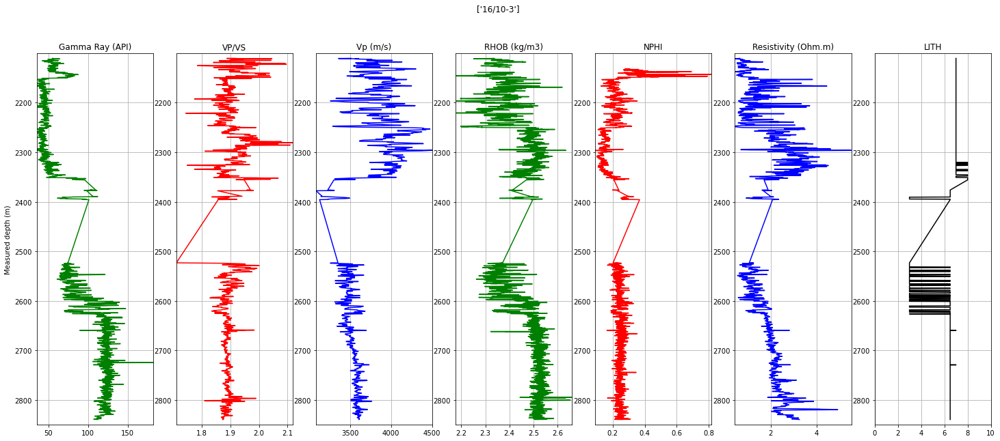

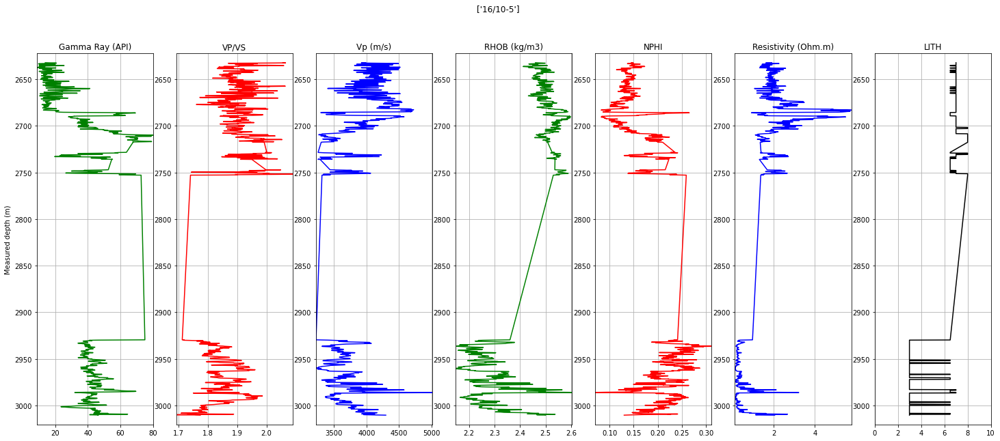

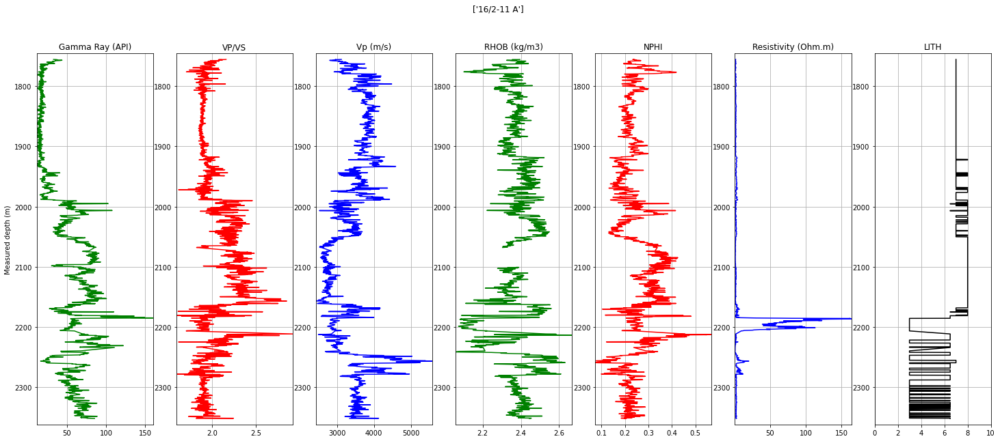

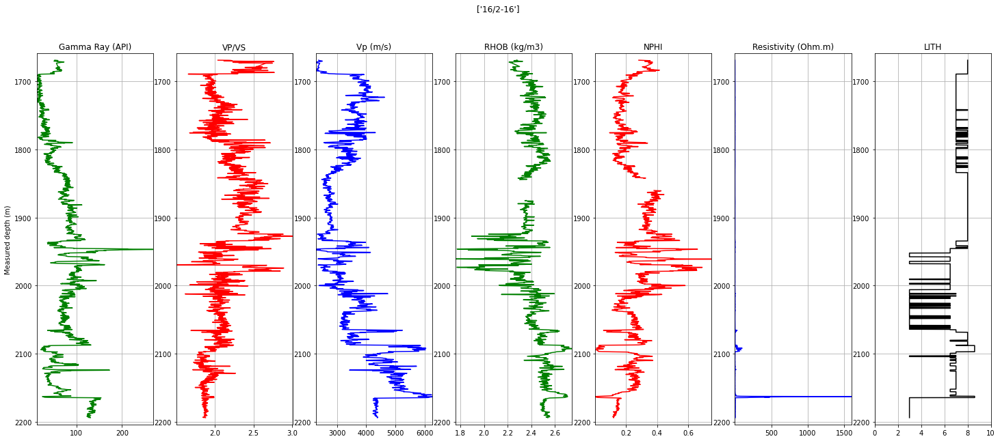

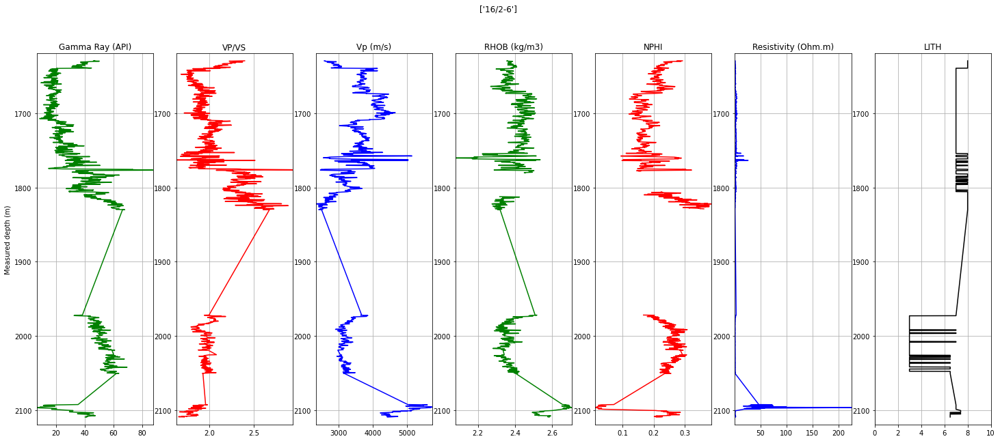

...

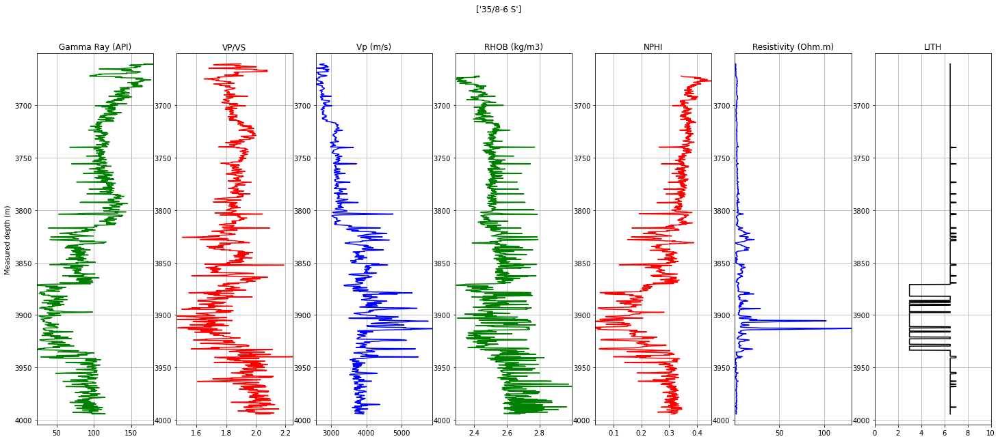

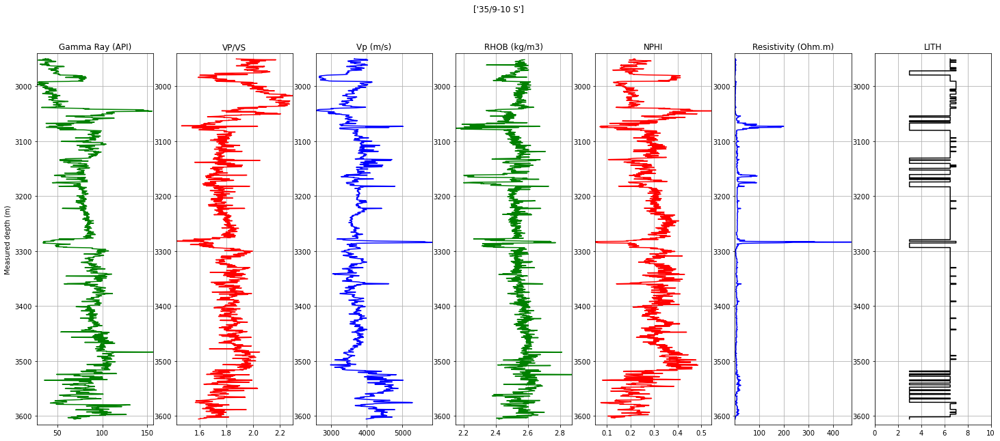

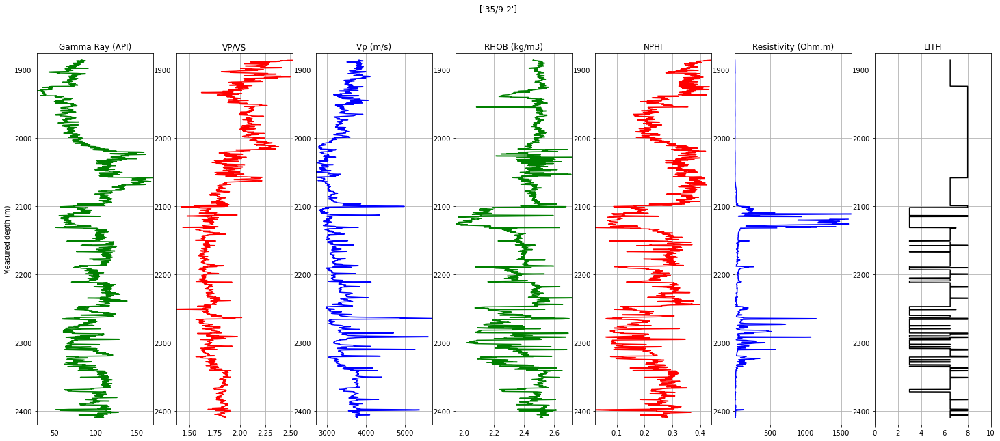

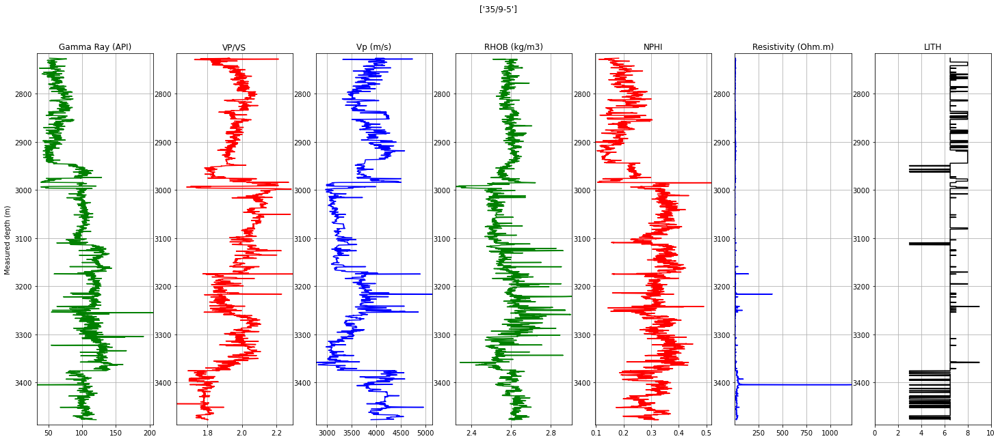

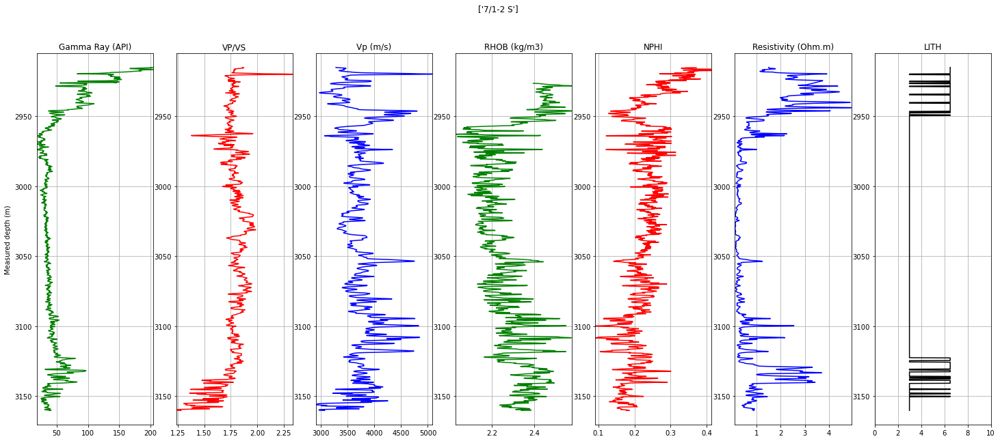

In [40]:
list_well=[]
for i in range(well_DTS.WELL.nunique()):
    print_well=well_DTS[well_DTS["WELL"]==well_list[i]].loc[:,:]
    plot_logs(print_well)
    list_well.append(print_well)

### Gráfico VP/VS  versus VP con color GammaRay para cada pozo. Las arenas se caracterizan con un valor de GR bajo (color azul),  buscamos a separalos del resto de las litologias en el espacio (VP/Vs  versus VP).

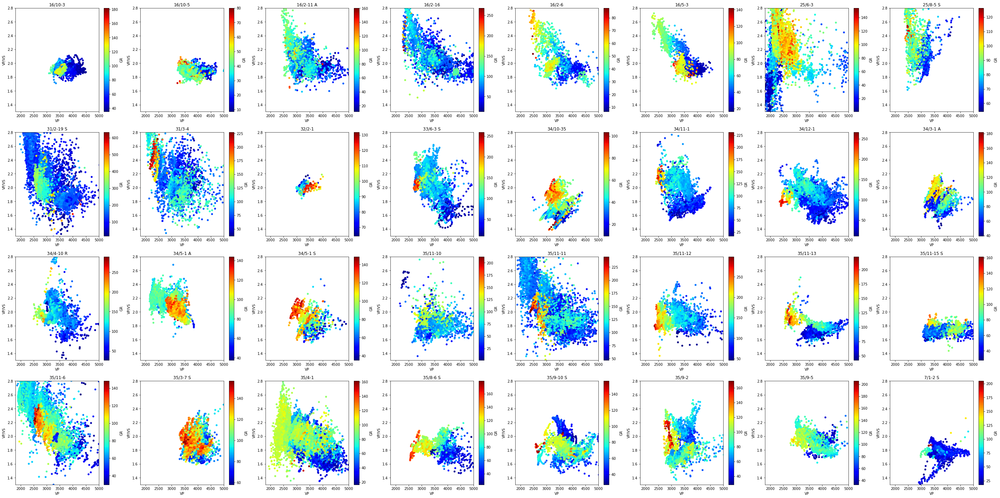

In [41]:
nrow=4
ncol=8

fig, axes = plt.subplots(nrow, ncol,figsize=(50,25))

count=0

for r in range(nrow):
    for c in range(ncol):
        list_well[count].plot(ax=axes[r,c],  kind = 'scatter', x = 'VP', y = 'VP/VS', c='GR', colormap='jet', ylim=(1.3, 2.8), xlim=(1800,5000),title=list(well_DTS.WELL.unique())[(8*r+c)])
        count+=1

### A partir de las imagenes de los pozos así generadas, interpretamos el rango óptimo de profundidad de cada pozo para focalisar en los intervalos de interés (arena).  Generamos (afuera del código)  un fichero csv depth range con valores de profundidad minima y maxima que cargamos para seguir con el análisis

In [42]:
depth_range=pd.read_csv("Depth_range_updated.csv",sep=";")

### Generación de los mismos plots con los nuevos rangos de profundidad

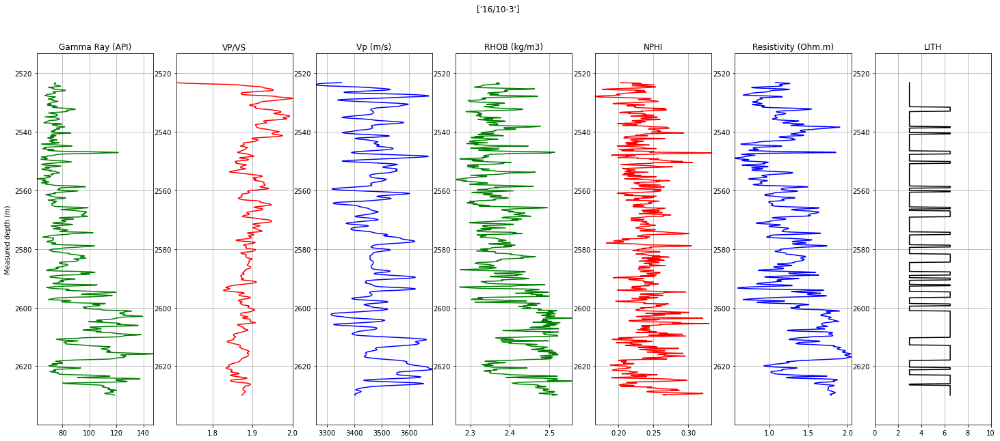

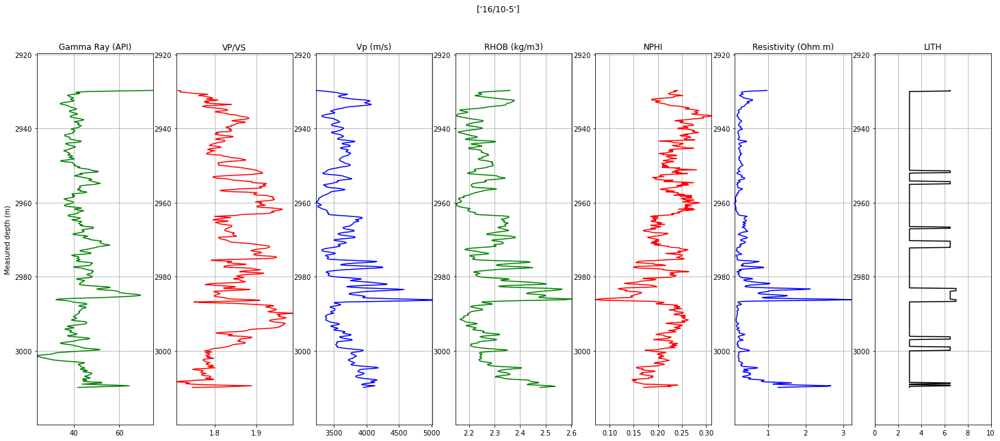

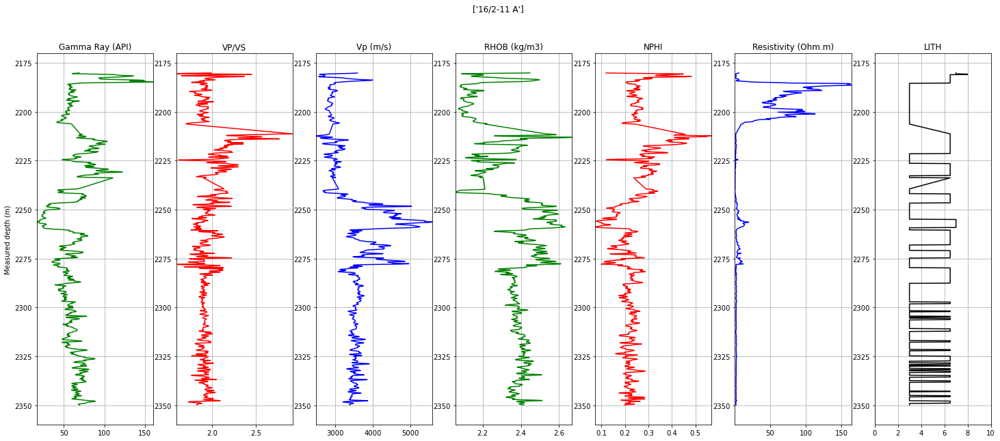

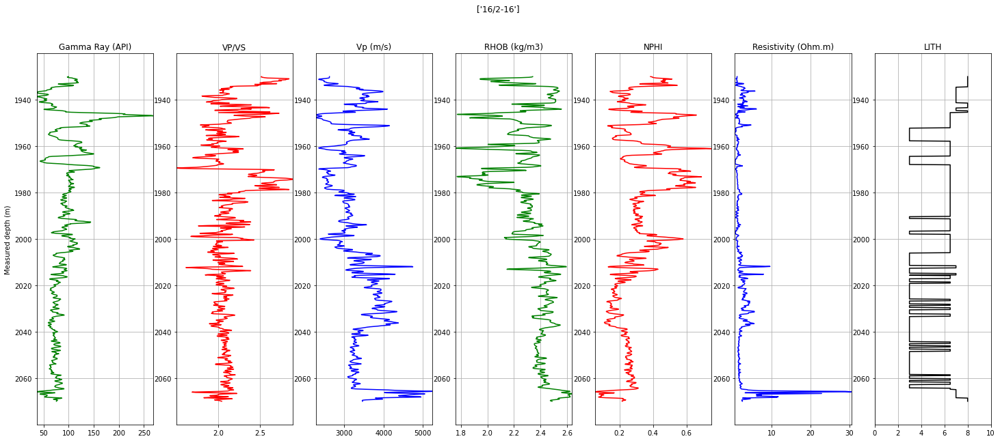

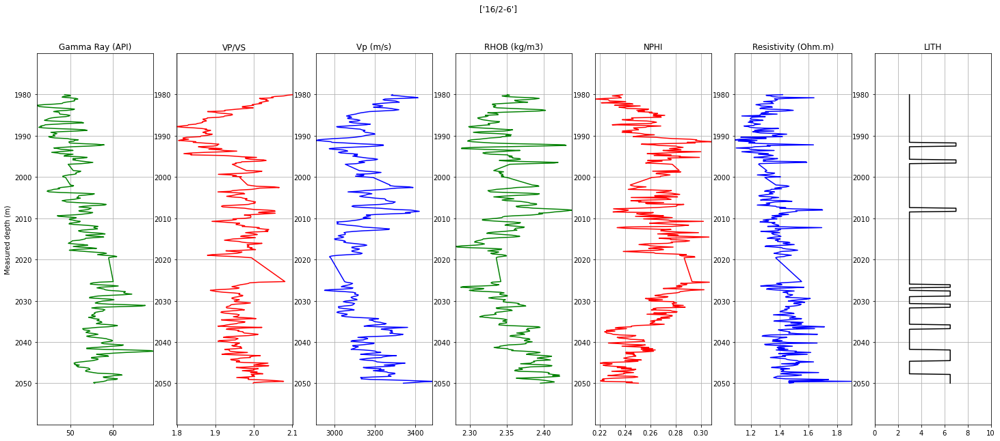

...

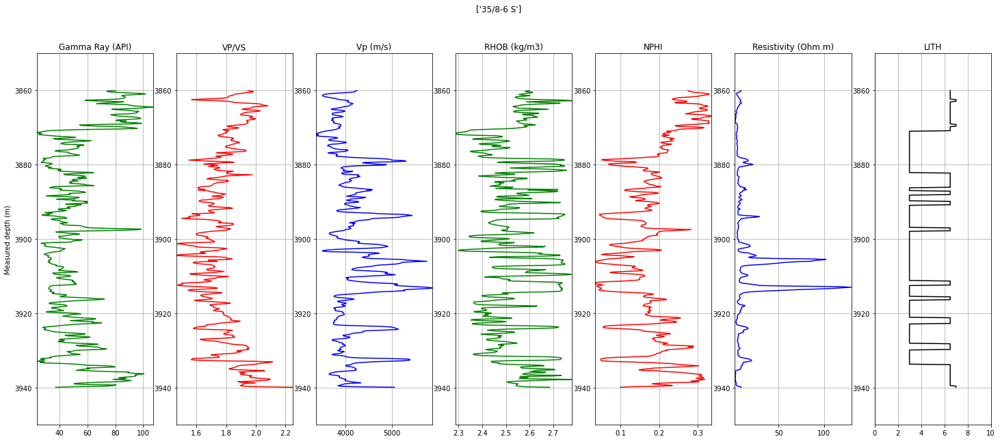

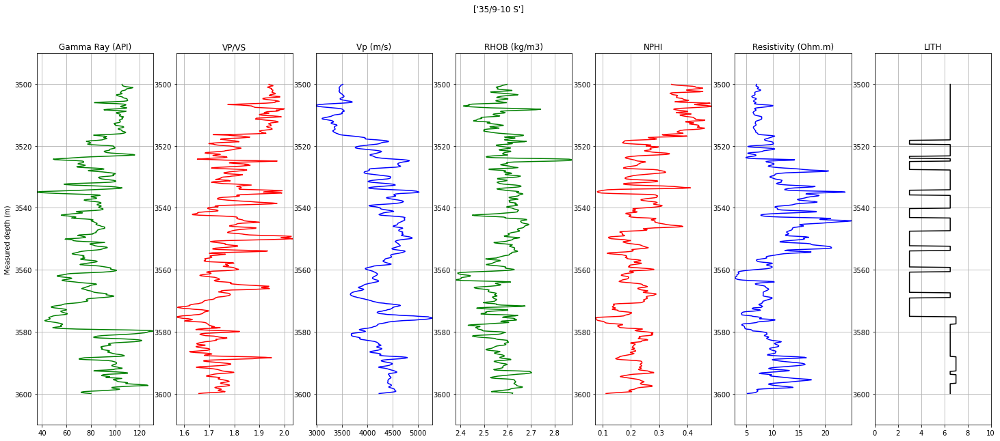

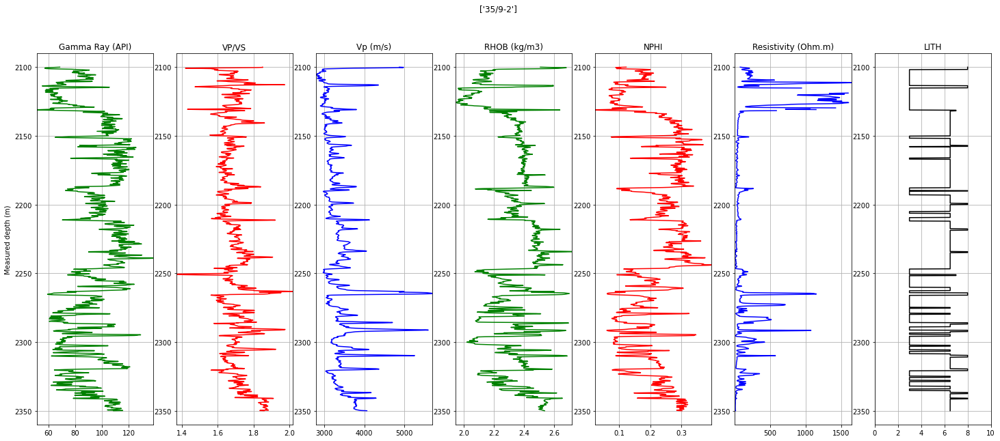

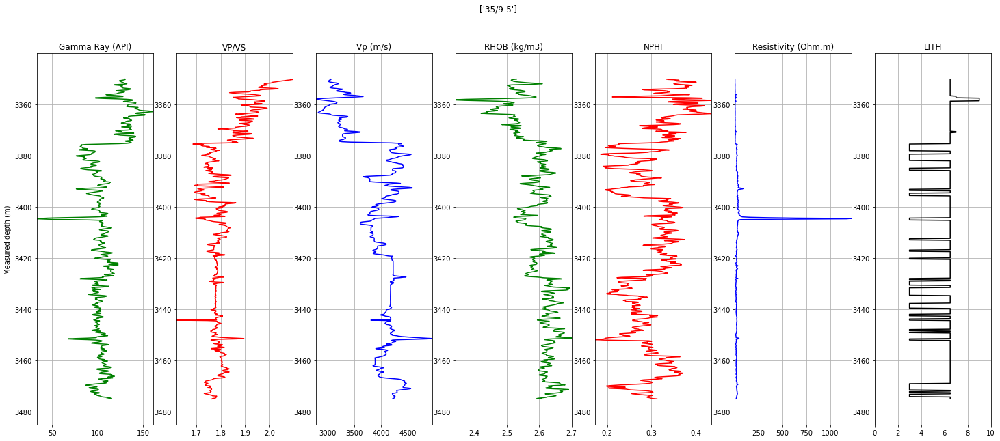

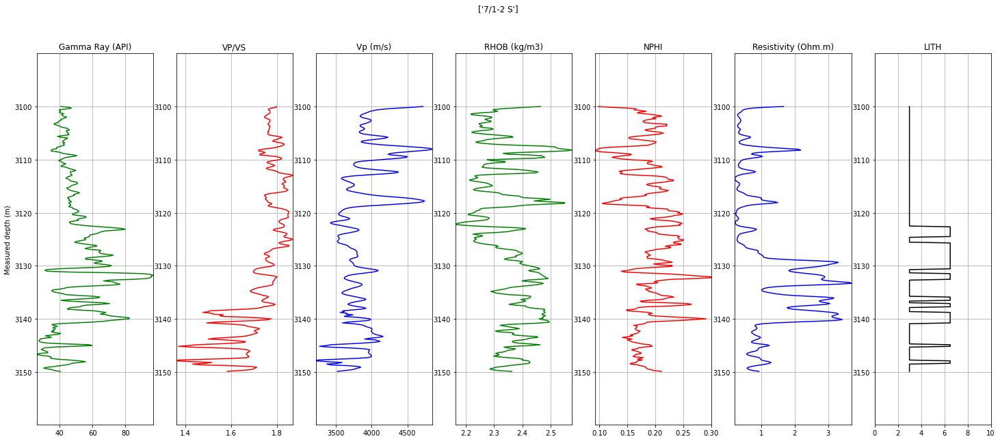

In [43]:
list_well_ed=[]
for i in range(well_DTS.WELL.nunique()):
    lwed=well_DTS[((well_DTS["DEPTH_MD"]<=depth_range.iloc[i][1])
    & (well_DTS["DEPTH_MD"]>=depth_range.iloc[i][0])) & (well_DTS["WELL"]==well_DTS.WELL.unique()[i])]
    plot_logs(lwed)
    list_well_ed.append(lwed)    


### Gráfico VP/VS  versus VP con color GammaRay para cada pozo con intervalo de profundidad optimizado. Se facilita la interpretación separandose mejor las arenas (valor de GammaRay bajo)

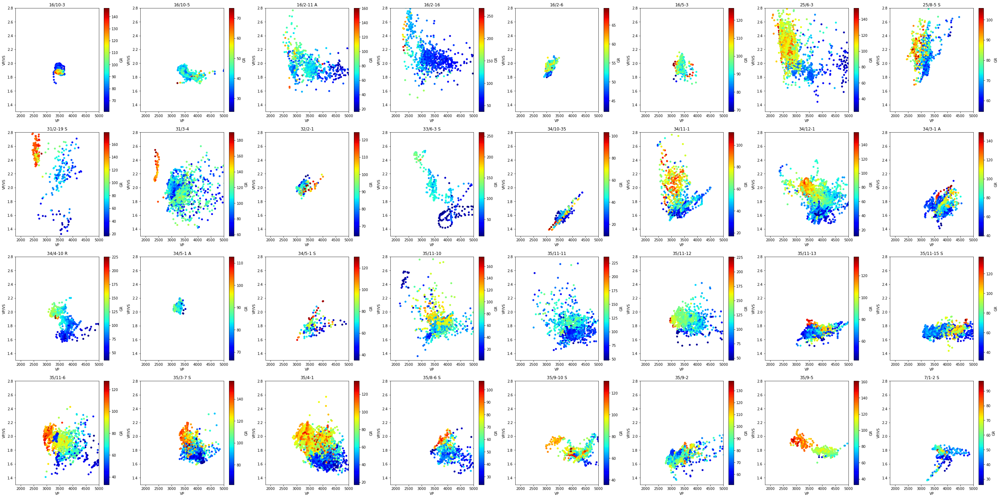

In [44]:
nrow=4
ncol=8

fig, axes = plt.subplots(nrow, ncol,figsize=(50,25))

count=0

for r in range(nrow):
    for c in range(ncol):
        list_well_ed[count].plot(ax=axes[r,c],  kind = 'scatter', x = 'VP', y = 'VP/VS', c='GR', colormap='jet', ylim=(1.3, 2.8), xlim=(1800,5000),title=list(well_DTS.WELL.unique())[(8*r+c)])
        count+=1

### Elegimos arbitrarmente 5 pozos en los cuales vemos la mejor separacion de las arenas (color azul).  Estos 5 pozos seran los pozos usados para intepretacion más fina

In [45]:
data_def=[list_well_ed[13],list_well_ed[20],list_well_ed[25],list_well_ed[26],list_well_ed[27]]
for i in range(len(data_def)):
    data_def[i].reset_index(inplace=True, drop=True) 

In [46]:
data_def[4].columns

well_DTS_def=pd.concat([data_def[0],data_def[1],data_def[2],data_def[3],data_def[4]])
well_DTS_def.shape

(10063, 19)

###  Generación e exportación del fichero con las longitudes y latitudes de los 5 pozos elegidos conteniendo el log DTS

In [47]:
data_coord_lon_lat_well_DTS_def=calc_coord(well_DTS_def)
data_coord_lon_lat_well_DTS_def

,WELL,DEPTH_MD,X_LOC,Y_LOC,lat,lon
0,34/11-1,4050.099000,473384.46875,6771838.0,61.080355,2.506652
1,35/11-11,3000.011600,530374.50000,6775166.0,61.109959,3.563552
2,35/3-7 S,3600.099851,543920.75000,6856652.5,61.840129,3.834194
3,35/4-1,4000.076000,516109.37500,6822434.0,61.535145,3.302959
4,35/8-6 S,3860.054800,518365.65625,6798576.0,61.320866,3.343032


In [48]:
data_coord_lon_lat_well_DTS_def.to_csv (r'./Output_data/all_coord_only_well_dts_final.csv', index = False, header=True)

### Exportación del fichero con los datos de los 5 pozos elegidos conteniendo el log DTS

In [49]:
well_DTS_def.to_csv (r'./Output_data/well_dts_final.csv', index = False, header=True)

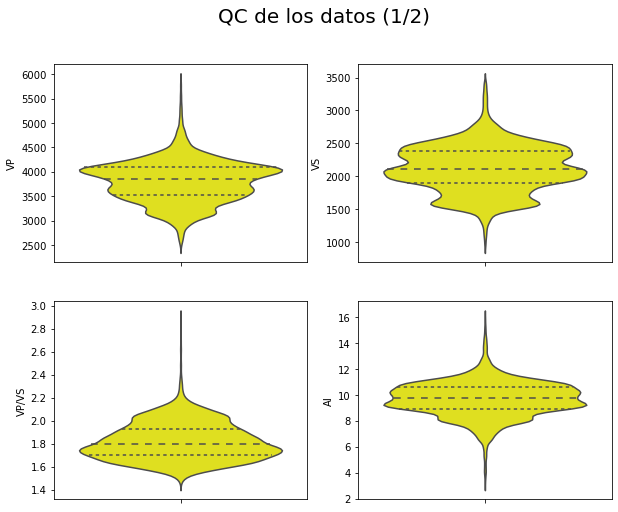

In [50]:
fig, axes = plt.subplots(2, 2, figsize=(10,8))

fig.suptitle('QC de los datos (1/2)', fontsize=20, color="black")

sns.violinplot(ax=axes[ 0,0], data=well_DTS_def,  y='VP',color='yellow', inner="quartile")
sns.violinplot(ax=axes[ 0,1], data=well_DTS_def, y='VS', color='yellow', inner="quartile")
sns.violinplot(ax=axes[ 1,0], data=well_DTS_def, y='VP/VS', color='yellow', inner="quartile")
sns.violinplot(ax=axes[ 1,1], data=well_DTS_def, y='AI', color='yellow', inner="quartile");


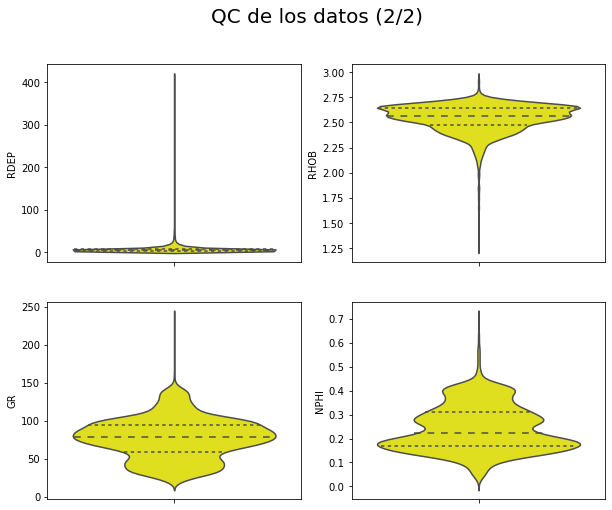

In [51]:
fig, axes = plt.subplots(2, 2, figsize=(10,8))

fig.suptitle('QC de los datos (2/2)', fontsize=20, color="black")

sns.violinplot(ax=axes[ 0,0], data=well_DTS_def,  y='RDEP',color='yellow', inner="quartile")
sns.violinplot(ax=axes[ 0,1], data=well_DTS_def, y='RHOB', color='yellow', inner="quartile")
sns.violinplot(ax=axes[ 1,0], data=well_DTS_def, y='GR', color='yellow', inner="quartile")
sns.violinplot(ax=axes[ 1,1], data=well_DTS_def, y='NPHI', color='yellow', inner="quartile");

### Generación e exportación de los graficos Plotly

In [52]:
p=well_DTS_def[well_DTS_def.WELL==well_DTS_def.WELL.unique()[0]]
plot_final(p);

In [53]:
p=well_DTS_def[well_DTS_def.WELL==well_DTS_def.WELL.unique()[1]]
plot_final(p);

In [54]:
p=well_DTS_def[well_DTS_def.WELL==well_DTS_def.WELL.unique()[2]]
plot_final(p);

In [55]:
p=well_DTS_def[well_DTS_def.WELL==well_DTS_def.WELL.unique()[3]]
plot_final(p);

In [56]:
p=well_DTS_def[well_DTS_def.WELL==well_DTS_def.WELL.unique()[4]]
plot_final(p);

In [57]:
import plotly.express as px
for i in range(well_DTS_def["WELL"].nunique()):
    p=well_DTS_def[well_DTS_def.WELL==well_DTS_def.WELL.unique()[i]]
    fig = px.scatter(p, x="AI", y="VP/VS", color="GR",
                title= p.WELL[0])
    fig.show()

In [58]:
for i in range(well_DTS_def["WELL"].nunique()):
    p=well_DTS_def[well_DTS_def.WELL==well_DTS_def.WELL.unique()[i]]
    fig = px.scatter(p, x="AI", y="VP/VS", color="LITH",
                title= p.WELL[0])
    fig.show()

### Generando el ultimo gráfico para cargar en Streamlit
##### última línea del código desactivada a proposito

In [59]:
p=well_DTS_def[well_DTS_def.WELL==well_DTS_def.WELL.unique()[3]]
fig = px.scatter(p, x="AI", y="VP/VS", color="GR",
                title= p.WELL[0])
fig.show()
#fig.write_html(r"./Images/Plot_Xplot_GR_w4.html")